# Exploratory Data Analysis (EDA)


---

## Goal of the EDA:
- ### Deal with the missing value in NLDAS variables 
    - Remove features that have too many missing values.
    - Fill in missing values using the forward interpolation method. 

- ### Feature selection
    - Retain those features that our EDA suggests to have a possible predictive ability of soybean yield.
    - Remove redundant features to avoid overfitting 
    - `TBD:` Decide whether we want to keep months after the typical soybean harvest season (Nov/Dec).
    - `Ongoing`: Decide which features from the previous winter matter. Currently focus on exploring the previous Nov and Dec rain, snow, and root zone soil moisture, as the soil moisture amount affected by these factors likely propagate to the following year. `If we do decide to include a few features from the previous winter, we will discard the first year in our time range.`
    - `TBD:` Decide whether to engineer other features (evaporative fraction, teleconnection indices)
    - `TBD:` Double-check possible nonlinear relationship between some climate variables and crop yield  


## To dos 
- ### Clean up the notebook and write up functions for repeatable procedures 

- ### Add notes from previous research findings 

- ### Clean up the notes and sections


---
# Background

In [292]:
from IPython.display import Image

## U.S. Soybean season

From [USDA](https://www.ers.usda.gov/topics/crops/soybeans-oil-crops/oil-crops-sector-at-a-glance/):
> Most U.S. soybeans are planted in May and early June and harvested in late September and October.

### Crop calendars for United States [source](https://ipad.fas.usda.gov/rssiws/al/crop_calendar/us.aspx)

![texte](https://ipad.fas.usda.gov/rssiws/al/crop_calendar/images/us_us_calendar.png)

## Literature findings

- [Impacts of compound hot–dry extremes on US soybean yields](https://esd.copernicus.org/articles/12/1371/2021/)
> The largest negative influence on soybean yields is driven by high temperature and low soil moisture during the summer crop reproductive period. 

### Load libraries 

In [1]:
import os
import math 
import xarray as xr
import pandas as pd
import numpy  as np
import seaborn as sns
import cartopy
import cartopy.crs as ccrs
import cartopy.feature as cfeature
from cartopy.mpl.gridliner import LONGITUDE_FORMATTER, LATITUDE_FORMATTER
cartopy.config['data_dir'] = os.getenv('CARTOPY_DIR', cartopy.config.get('data_dir'))

import geopandas as gpd
import cmocean

from matplotlib import pyplot as plt
#%config InlineBackend.figure_format = 'retina'
plt.ion()  # To trigger the interactive inline mode

import warnings
warnings.filterwarnings("ignore", category=RuntimeWarning) 

from functools import reduce
from netCDF4 import Dataset

---
### Read in the combined dataframe 

In [2]:
data = pd.read_csv('GDHY_soybean_NLDAS_1981-2016.csv')

In [3]:
data.head()

,Unnamed: 0,lat,lon,year,yield,SWdown_Jan,LWdown_Jan,SWnet_Jan,LWnet_Jan,Qle_Jan,...,CCond_Dec,RCS_Dec,RCT_Dec,RCQ_Dec,RCSOL_Dec,RSmin_Dec,RSMacr_Dec,LAI_Dec,GVEG_Dec,Streamflow_Dec
0,0,25.25,252.25,1981,1.222455,159.92084,346.99466,130.236630,-58.938140,49.757866,...,0.003209,0.296489,0.945595,0.761561,0.507833,70.00,0.160229,2.580852,0.408217,NaN
1,1,25.25,261.75,1981,0.730697,123.25622,340.83930,90.953440,-47.860847,30.156218,...,0.002931,0.291933,0.928706,0.841513,0.488691,70.00,0.039061,2.136915,0.169220,NaN
2,2,25.75,251.75,1981,0.720959,158.17145,344.05258,129.672600,-61.418865,50.223950,...,0.003299,0.296670,0.945852,0.769458,0.514206,70.00,0.045652,2.528653,0.379176,NaN
3,3,25.75,252.25,1981,1.450878,157.28096,329.23950,131.438960,-59.363853,51.495888,...,0.003447,0.259533,0.905129,0.762109,0.399981,70.00,0.079119,4.030976,0.552567,NaN
4,4,25.75,261.25,1981,1.049755,121.04869,334.77954,86.365326,-48.992542,26.840885,...,0.002115,0.280767,0.898908,0.856690,0.518298,138.75,0.038237,2.069846,0.207283,NaN


---
## EDA of the yield data 

### Distribution of the yield data 

Text(0.5, 1.0, 'U.S. Soybean annual yield [$t$ $ha^{-1}$]')

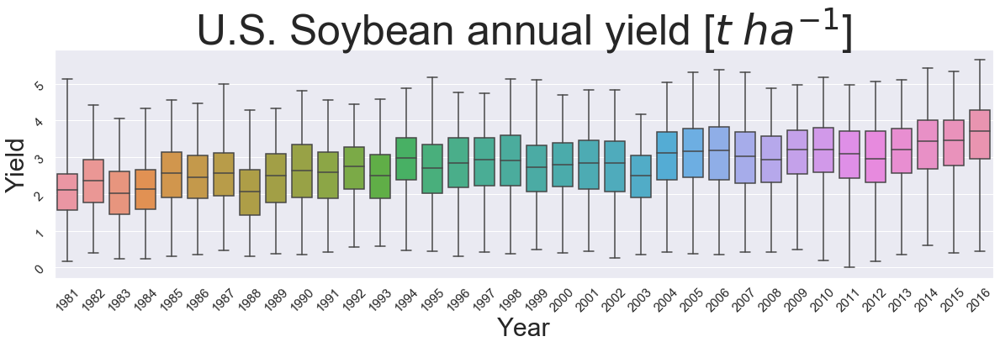

In [279]:
#define figure size
sns.set(rc={"figure.figsize":(20, 5)}) #width=8, height=4

ax = sns.boxplot(x='year', y='yield', data=data, whis=10)
ax.set_ylabel('Yield', fontsize= 30)
ax.set_xlabel('Year', fontsize = 30)
ax.tick_params(labelsize=15, rotation=45)
ax.set_title('U.S. Soybean annual yield ['+ r'$t$ $ha^{-1}$'+']', fontsize = 50)

# `To do : add maps showing climatology, trend, and variability. The goal is to get a sense of spatial variation in the soybean yield. ` 

---
## EDA of the NLDAS data 

### Our focus:

- ### Recall that we have multiple variables from the NLDAS data, and we will likely won't need that many for our modeling. We will exclude variables that fall into the following categories:
    1. The variable directly reflects the yield data. This kind of variable has strong correlation with the yield data, but does not necessarily provide predictive power. Example: LAI. 
    2. Variables that do not yield strong correaltions with the annual yield will likely not to effectively affect yield.
    3. Some variables are strongly correlated with each other, therefore it's not necessary to include all of them in our input feature vector. 
    4. Variables that have too many missing values can be directly discarded. 


### Let's first to get familar with all the variables that we have. 

### We will borrow the raw .nc4 file to obtain this information. 

In [5]:
path_NLDAS         = '/Users/wenwen/Downloads/CropYield/DATA/NLDAS/'
test_NLDAS_ds      = xr.open_dataset(path_NLDAS + 'NLDAS_NOAH0125_M.A198101.020.nc.SUB.nc4')
test_NLDAS_df      = test_NLDAS_ds.to_dataframe()

# .reset_index() helps to assign lat and lon for each entry
test_NLDAS_df      = test_NLDAS_df.reset_index()

# Read in bnds 0 only, and sort values by the ascending order of lat and lon
test_NLDAS_sorted  = test_NLDAS_df[test_NLDAS_df['bnds'] == 0].sort_values(by = ['lat', 'lon'])
NLDAS_column_names = list(test_NLDAS_sorted)
NLDAS_column_names

['bnds',
 'lat',
 'lon',
 'time',
 'time_bnds',
 'SWdown',
 'LWdown',
 'SWnet',
 'LWnet',
 'Qle',
 'Qh',
 'Qg',
 'Qf',
 'Snowf',
 'Rainf',
 'Evap',
 'Qs',
 'Qsb',
 'Qsm',
 'AvgSurfT',
 'Albedo',
 'SWE',
 'SnowDepth',
 'SnowFrac',
 'SoilT_0_10cm',
 'SoilT_10_40cm',
 'SoilT_40_100cm',
 'SoilT_100_200cm',
 'SoilM_0_10cm',
 'SoilM_10_40cm',
 'SoilM_40_100cm',
 'SoilM_100_200cm',
 'SoilM_0_100cm',
 'SoilM_0_200cm',
 'RootMoist',
 'SMLiq_0_10cm',
 'SMLiq_10_40cm',
 'SMLiq_40_100cm',
 'SMLiq_100_200cm',
 'SMAvail_0_100cm',
 'SMAvail_0_200cm',
 'PotEvap',
 'ECanop',
 'TVeg',
 'ESoil',
 'SubSnow',
 'CanopInt',
 'ACond',
 'CCond',
 'RCS',
 'RCT',
 'RCQ',
 'RCSOL',
 'RSmin',
 'RSMacr',
 'LAI',
 'GVEG',
 'Streamflow']

In [6]:
NLDAS_variable_list = NLDAS_column_names[5:len(NLDAS_column_names)]
NLDAS_variable_list

['SWdown',
 'LWdown',
 'SWnet',
 'LWnet',
 'Qle',
 'Qh',
 'Qg',
 'Qf',
 'Snowf',
 'Rainf',
 'Evap',
 'Qs',
 'Qsb',
 'Qsm',
 'AvgSurfT',
 'Albedo',
 'SWE',
 'SnowDepth',
 'SnowFrac',
 'SoilT_0_10cm',
 'SoilT_10_40cm',
 'SoilT_40_100cm',
 'SoilT_100_200cm',
 'SoilM_0_10cm',
 'SoilM_10_40cm',
 'SoilM_40_100cm',
 'SoilM_100_200cm',
 'SoilM_0_100cm',
 'SoilM_0_200cm',
 'RootMoist',
 'SMLiq_0_10cm',
 'SMLiq_10_40cm',
 'SMLiq_40_100cm',
 'SMLiq_100_200cm',
 'SMAvail_0_100cm',
 'SMAvail_0_200cm',
 'PotEvap',
 'ECanop',
 'TVeg',
 'ESoil',
 'SubSnow',
 'CanopInt',
 'ACond',
 'CCond',
 'RCS',
 'RCT',
 'RCQ',
 'RCSOL',
 'RSmin',
 'RSMacr',
 'LAI',
 'GVEG',
 'Streamflow']

In [7]:
test_NLDAS_ds[NLDAS_variable_list[0]]

<xarray.DataArray 'SWdown' (time: 1, lat: 56, lon: 116)>
array([[[36.485916, 36.505207, ..., 44.69264 , 43.970695],
        [36.56395 , 36.80454 , ..., 43.995026, 44.230984],
        ...,
        [      nan,       nan, ...,       nan,       nan],
        [      nan,       nan, ...,       nan,       nan]]], dtype=float32)
Coordinates:
  * time     (time) datetime64[ns] 1981-01-01
  * lon      (lon) float64 235.2 235.8 236.2 236.8 ... 291.2 291.8 292.2 292.8
  * lat      (lat) float64 52.75 52.25 51.75 51.25 ... 26.75 26.25 25.75 25.25
Attributes:
    standard_name:  Surface incident shortwave radiation
    long_name:      Shortwave radiation flux downwards (surface)
    units:          W m-2
    cell_methods:   time: mean
    vmin:           30.337355
    vmax:           203.82982

In [39]:
NLDAS_variable_name_units = []
for index in range(0,len(NLDAS_variable_list)):
    name      = test_NLDAS_ds[NLDAS_variable_list[index]].standard_name
    units     = test_NLDAS_ds[NLDAS_variable_list[index]].units
    name_units= name + ' ('+units+')'
    NLDAS_variable_name_units.append(name_units)


In [40]:
NLDAS_variable_dict = dict(zip(NLDAS_variable_list, NLDAS_variable_name_units))
NLDAS_variable_dict

{'SWdown': 'Surface incident shortwave radiation (W m-2)',
 'LWdown': 'Surface incident longwave radiation (W m-2)',
 'SWnet': 'Surface net shortwave radiation (W m-2)',
 'LWnet': 'Surface net longwave radiation (W m-2)',
 'Qle': 'Latent heat flux (W m-2)',
 'Qh': 'Sensible heat flux (W m-2)',
 'Qg': 'Ground heat flux (W m-2)',
 'Qf': 'Energy of fusion (W m-2)',
 'Snowf': 'Snowfall rate (kg m-2)',
 'Rainf': 'Rainfall rate (kg m-2)',
 'Evap': 'Total evapotranspiration (kg m-2)',
 'Qs': 'Surface runoff (kg m-2)',
 'Qsb': 'Subsurface runoff (kg m-2)',
 'Qsm': 'Snowmelt (kg m-2)',
 'AvgSurfT': 'Average surface temperature (K)',
 'Albedo': 'Surface albedo (%)',
 'SWE': 'Snow Water Equivalent (kg m-2)',
 'SnowDepth': 'Snow depth (m)',
 'SnowFrac': 'Snow covered fraction (fraction)',
 'SoilT_0_10cm': 'Average layer soil temperature (K)',
 'SoilT_10_40cm': 'Average layer soil temperature (K)',
 'SoilT_40_100cm': 'Average layer soil temperature (K)',
 'SoilT_100_200cm': 'Average layer soil temp

### The long_name of each variable will give us a better sense of their physical meanings. 

### Several observations and questions

- ### Soil temperature, soil moisture content, liquid soil moisture content, and soil moisture availability across different soil depths are provided. Do we need them all? 

- ### Several vegetation related variables are highly related to the crop yield, such as canopy conductance, stomatal resistance, LAI, and Green vegetation fraction. We should double check whether we need to include all months of these variables. 

### Check the NaN values 

In [10]:
data_columns       = data.columns
data_NLDAS_columns = data_columns[5:641]

In [11]:
data.info

<bound method DataFrame.info of        Unnamed: 0    lat     lon  year     yield  SWdown_Jan  LWdown_Jan  \
0               0  25.25  252.25  1981  1.222455  159.920840   346.99466   
1               1  25.25  261.75  1981  0.730697  123.256220   340.83930   
2               2  25.75  251.75  1981  0.720959  158.171450   344.05258   
3               3  25.75  252.25  1981  1.450878  157.280960   329.23950   
4               4  25.75  261.25  1981  1.049755  121.048690   334.77954   
...           ...    ...     ...   ...       ...         ...         ...   
53379       53379  48.75  264.75  2016  3.735792   58.571480   226.91599   
53380       53380  48.75  287.25  2016  2.936604   68.403190   238.82240   
53381       53381  48.75  287.75  2016  2.824051         NaN         NaN   
53382       53382  48.75  288.25  2016  2.862302   70.961464   240.11539   
53383       53383  48.75  288.75  2016  3.414211   64.889366   234.43861   

        SWnet_Jan  LWnet_Jan    Qle_Jan  ...     CCond_

In [12]:
range(0,len(data_NLDAS_columns))

range(0, 636)

In [13]:
total_counts = 53384
for index in range(0,len(data_NLDAS_columns)):
    column = data_NLDAS_columns[index]
    if data[column].isnull().values.any():
        print('NaN exists ('+str(data[column].isna().sum())+') : '+ column)

NaN exists (285) : SWdown_Jan
NaN exists (285) : LWdown_Jan
NaN exists (285) : SWnet_Jan
NaN exists (285) : LWnet_Jan
NaN exists (285) : Qle_Jan
NaN exists (285) : Qh_Jan
NaN exists (285) : Qg_Jan
NaN exists (285) : Qf_Jan
NaN exists (285) : Snowf_Jan
NaN exists (285) : Rainf_Jan
NaN exists (285) : Evap_Jan
NaN exists (285) : Qs_Jan
NaN exists (285) : Qsb_Jan
NaN exists (285) : Qsm_Jan
NaN exists (285) : AvgSurfT_Jan
NaN exists (285) : Albedo_Jan
NaN exists (285) : SWE_Jan
NaN exists (285) : SnowDepth_Jan
NaN exists (285) : SnowFrac_Jan
NaN exists (285) : SoilT_0_10cm_Jan
NaN exists (285) : SoilT_10_40cm_Jan
NaN exists (285) : SoilT_40_100cm_Jan
NaN exists (285) : SoilT_100_200cm_Jan
NaN exists (285) : SoilM_0_10cm_Jan
NaN exists (285) : SoilM_10_40cm_Jan
NaN exists (285) : SoilM_40_100cm_Jan
NaN exists (285) : SoilM_100_200cm_Jan
NaN exists (285) : SoilM_0_100cm_Jan
NaN exists (285) : SoilM_0_200cm_Jan
NaN exists (285) : RootMoist_Jan
NaN exists (285) : SMLiq_0_10cm_Jan
NaN exists (28

NaN exists (285) : SMLiq_40_100cm_Nov
NaN exists (285) : SMLiq_100_200cm_Nov
NaN exists (285) : SMAvail_0_100cm_Nov
NaN exists (285) : SMAvail_0_200cm_Nov
NaN exists (285) : PotEvap_Nov
NaN exists (285) : ECanop_Nov
NaN exists (285) : TVeg_Nov
NaN exists (285) : ESoil_Nov
NaN exists (285) : SubSnow_Nov
NaN exists (285) : CanopInt_Nov
NaN exists (285) : ACond_Nov
NaN exists (285) : CCond_Nov
NaN exists (285) : RCS_Nov
NaN exists (285) : RCT_Nov
NaN exists (285) : RCQ_Nov
NaN exists (285) : RCSOL_Nov
NaN exists (285) : RSmin_Nov
NaN exists (285) : RSMacr_Nov
NaN exists (285) : LAI_Nov
NaN exists (285) : GVEG_Nov
NaN exists (3175) : Streamflow_Nov
NaN exists (285) : SWdown_Dec
NaN exists (285) : LWdown_Dec
NaN exists (285) : SWnet_Dec
NaN exists (285) : LWnet_Dec
NaN exists (285) : Qle_Dec
NaN exists (285) : Qh_Dec
NaN exists (285) : Qg_Dec
NaN exists (285) : Qf_Dec
NaN exists (285) : Snowf_Dec
NaN exists (285) : Rainf_Dec
NaN exists (285) : Evap_Dec
NaN exists (285) : Qs_Dec
NaN exists (

### Curious about where the missing values locate 


# `To do: define function to plot out the NaN values`

In [14]:
SWdown_Jan = data['SWdown_Jan']
lats       = data['lat']
lons       = data['lon']

In [15]:
SWdown_NaN    = data[['lat', 'lon', 'SWdown_Jan']]
SWdown_NaN['SWdown_Jan'] = 0
for index in range(0,len(SWdown_Jan)):
    if math.isnan(SWdown_Jan[index]):
        #print('lat = '+str(lats[index]) + ', lon = '+str(lons[index])) 
        SWdown_NaN['SWdown_Jan'][index] = 10

/Users/wenwen/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  This is separate from the ipykernel package so we can avoid doing imports until
/Users/wenwen/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
/Users/wenwen/opt/anaconda3/lib/python3.7/site-packages/IPython/core/interactiveshell.py:3331: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation:

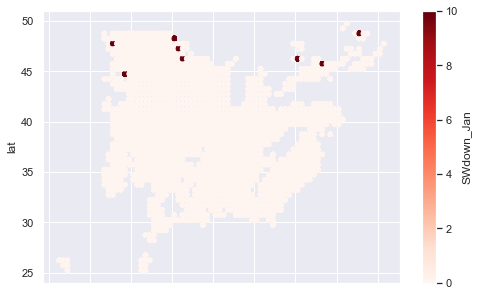

In [16]:
sns.set(rc={"figure.figsize":(8, 5)}) #width=8, height=4
SWdown_NaN.plot(x = 'lon', y = 'lat', kind = 'scatter', c = 'SWdown_Jan', colormap = 'Reds')

In [17]:
SWdown_NaN.info

<bound method DataFrame.info of          lat     lon  SWdown_Jan
0      25.25  252.25           0
1      25.25  261.75           0
2      25.75  251.75           0
3      25.75  252.25           0
4      25.75  261.25           0
...      ...     ...         ...
53379  48.75  264.75           0
53380  48.75  287.25           0
53381  48.75  287.75          10
53382  48.75  288.25           0
53383  48.75  288.75           0

[53384 rows x 3 columns]>

In [18]:
Streamflow_Jan = data['Streamflow_Jan']

In [19]:
Streamflow_NaN    = data[['lat', 'lon', 'Streamflow_Jan']]
Streamflow_NaN['Streamflow_Jan'] = 0
for index in range(0,len(Streamflow_Jan)):
    if math.isnan(Streamflow_Jan[index]):
        #print('lat = '+str(lats[index]) + ', lon = '+str(lons[index])) 
        Streamflow_NaN['Streamflow_Jan'][index] = 10

/Users/wenwen/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
/Users/wenwen/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
/Users/wenwen/opt/anaconda3/lib/python3.7/site-packages/IPython/core/interactiveshell.py:3331: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-v

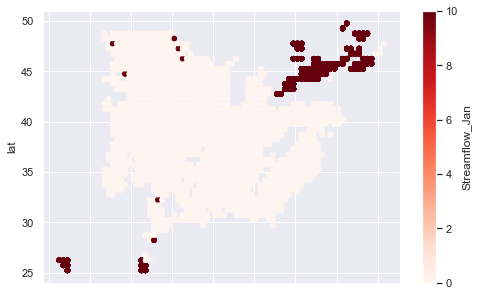

In [20]:
sns.set(rc={"figure.figsize":(8, 5)}) #width=8, height=4
Streamflow_NaN.plot(x = 'lon', y = 'lat', kind = 'scatter', c = 'Streamflow_Jan', colormap = 'Reds')

# Deal with NaN values

### Replace NaN values with their nearest values 

In [21]:
data_columns       = data.columns
data_filled        = data

In [22]:
for index in range(0,len(data_columns)):
    column = data_columns[index]
    if data_filled[column].isnull().values.any():
        data_filled[column].interpolate(method='linear', direction='forward', inplace=True)

In [23]:
for index in range(0,len(data_columns)):
    column = data_columns[index]
    if data_filled[column].isnull().values.any():
        print('NaN exists ('+str(data_filled[column].isna().sum())+') : '+ column)

NaN exists (9) : Streamflow_Jan
NaN exists (9) : Streamflow_Feb
NaN exists (9) : Streamflow_Mar
NaN exists (9) : Streamflow_Apr
NaN exists (9) : Streamflow_May
NaN exists (9) : Streamflow_Jun
NaN exists (9) : Streamflow_Jul
NaN exists (9) : Streamflow_Aug
NaN exists (9) : Streamflow_Sep
NaN exists (9) : Streamflow_Oct
NaN exists (9) : Streamflow_Nov
NaN exists (9) : Streamflow_Dec


### Streamflow still contains NaN after the interpolation method, likely because there are a bunch of NaN points in the Northeastern U.S. whose nearest neighbors are also NaNs.

---
## Exploring the correlation between annual yield and monthly climate variables 


### Below is a list of variables that most likely have a strong effects on crop yield
### We grouped the variables that have closer physical process/meanings/effects together
### It's likely that we only need a few variables from each of these groups, as within each group, one variable may closely related to the other. That's what we want to find out. 

#### Suface energy flux variables:

- 'SWdown': 'Shortwave radiation flux downwards (surface) (W m-2)'
- 'LWdown': 'Longwave radiation flux downwards (surface) (W m-2)'
- 'SWnet': 'Net shortwave radiation flux (surface) (W m-2)'
- 'LWnet': 'Net longwave radiation flux (surface) (W m-2)'
- 'Qle': 'Latent heat flux (W m-2)'
- 'Qh': 'Sensible heat flux (W m-2)'
- 'Qg': 'Ground heat flux (W m-2)'

#### Surface water flux / storage variables:
- 'Qf': 'Snow phase-change heat flux (W m-2)'
- 'Snowf': 'Frozen precipitation (snowfall) (kg m-2)'
- 'Rainf': 'Liquid precipitation (rainfall) (kg m-2)'
- 'Evap': 'Total evapotranspiration (kg m-2)'
- 'Qs': 'Surface runoff (non-infiltrating) (kg m-2)'
- 'Qsb': 'Subsurface runoff (baseflow) (kg m-2)'
- 'Qsm': 'Snowmelt (kg m-2)'
- 'SWE': 'Snow Water Equivalent (kg m-2)'
- 'SnowDepth': 'Snow depth (m)'
- 'SnowFrac': 'Snow cover (fraction)'
- 'PotEvap': 'Potential evapotranspiration (W m-2)'
- 'ECanop': 'Canopy water evaporation (W m-2)'
- 'TVeg': 'Transpiration (W m-2)'
- 'ESoil': 'Direct evaporation from bare soil (W m-2)'
- 'SubSnow': 'Sublimation (evaporation from snow) (W m-2)'
- 'CanopInt': 'Plant canopy surface water (kg m-2)'

#### Temperature related variables
- 'AvgSurfT': 'Average surface skin temperature (K)'
- 'Albedo': 'Surface albedo (%)'

#### Soil temperature
- 'SoilT_0_10cm': 'Soil temperature (0-10cm) (K)'
- 'SoilT_10_40cm': 'Soil temperature (10-40cm) (K)'
- 'SoilT_40_100cm': 'Soil temperature (40-100cm) (K)'
- 'SoilT_100_200cm': 'Soil temperature (100-200cm) (K)'

#### Soil moisture
- 'SoilM_0_10cm': 'Soil moisture content (0-10cm) (kg m-2)'
- 'SoilM_10_40cm': 'Soil moisture content (10-40cm) (kg m-2)'
- 'SoilM_40_100cm': 'Soil moisture content (40-100cm) (kg m-2)'
- 'SoilM_100_200cm': 'Soil moisture content (100-200cm) (kg m-2)'
- 'SoilM_0_100cm': 'Soil moisture content (0-100cm) (kg m-2)'
- 'SoilM_0_200cm': 'Soil moisture content (0-200cm) (kg m-2)'
- 'RootMoist': 'Root zone soil moisture (kg m-2)'
 
#### Soil liquid moisture content  
- 'SMLiq_0_10cm': 'Liquid soil moisture content (0-10cm) (kg m-2)'
- 'SMLiq_10_40cm': 'Liquid soil moisture content (10-40cm) (kg m-2)'
- 'SMLiq_40_100cm': 'Liquid soil moisture content (40-100cm) (kg m-2)'
- 'SMLiq_100_200cm': 'Liquid soil moisture content (100-200cm) (kg m-2)'

#### Soil moisture availability
- 'SMAvail_0_100cm': 'Soil moisture availability (0-100cm) (%)'
- 'SMAvail_0_200cm': 'Soil moisture availability (0-200cm) (%)'
 
 
### Below is a list of variables that we will not consider either due to missing value or due to the fact that the variable itself directly reflects crop yield in the current year

- 'LAI': 'Leaf Area Index (unitless)'
- 'GVEG': 'Green vegetation (fraction)'
- 'Streamflow': 'Streamflow (m^3 sec-1)'

### Below is a list of land surface parameters provided by NLDAS. These parameters a closely related to surface vegetation cover, so likely a direct reflection of the crop yield in the current year. 
- 'ACond': 'Aerodynamic conductance (m s-1)'
- 'CCond': 'Canopy conductance (m s-1)'
- 'RCS': 'Solar parameter in canopy conductance (fraction)'
- 'RCT': 'Temperature parameter in canopy conductance (fraction)'
- 'RCQ': 'Humidity parameter in canopy conductance (fraction)'
- 'RCSOL': 'Soil moisture parameter in canopy conductance (fraction)'
- 'RSmin': 'Minimal stomatal resistance (s m-1)'
- 'RSMacr': 'Relative soil moist. availability control factor (0-1)'

---
# Correlation heatmaps 

## Between annual yield and monthly suface energy flux variables:

- 'SWdown': 'Shortwave radiation flux downwards (surface) (W m-2)'
- 'LWdown': 'Longwave radiation flux downwards (surface) (W m-2)'
- 'SWnet': 'Net shortwave radiation flux (surface) (W m-2)'
- 'LWnet': 'Net longwave radiation flux (surface) (W m-2)'
- 'Qle': 'Latent heat flux (W m-2)'
- 'Qh': 'Sensible heat flux (W m-2)'
- 'Qg': 'Ground heat flux (W m-2)'

---
## Correlation heatmaps: yield vs surface radiative fluxes

### It suggests that June and July SWdown and SWnet have strong negative correlation with soybean annual yield.

### Annual yield also have strong positive correlation with LWnet during the growing season

## Define function to plot out the correlation heatmaps

In [61]:
def corr_heatmap_yield_climate(var, title):
    '''
    Purpose:
    Correlation heatmaps for visualizing the pairwise pearson correlation between yield and climate variables.
    Particularly, these heatmaps give us hints about:
    (1) Which local climate conditions matter for the annual yield.
    (2) Which climate variables are highly correlated with each other and thus are redundant features.
    
    
    Parameters:
    var is a list of climate variable names; title is a user-defined suptitle for the panel plot
    
    Caveat:
    This approach is based on a linear correlation assumption. 
    Therefore, a weak correlation != no correlation. 
    It's worth checking other visualizations (such as scatter plot) to confirm 
    whether you want to keep a certain feature or not. 
    
    '''
    
    plt.figure(figsize=(60,60))
    plt.subplots_adjust(hspace=0.3)
    plt.subplots_adjust(wspace=0.1)
    plt.suptitle("Correlation heatmaps : "+title, fontsize=100, y = 1.0)

    sns.set(font_scale=3)

    # ---- set number of columns 
    ncols     = 2
    # ---- calculate number of rows
    nrows = len(var) // ncols + (len(var) % ncols > 0)
    
    # loop through the length of var list and keep track of index
    for n, item in enumerate(var):
        # ---- add a new subplot iteratively using nrows and cols
        ax   = plt.subplot(nrows, ncols, n + 1)
    
        cols = [col for col in data_filled.columns if col.startswith('yield') or col.startswith(item+'_')]
        df   = data_filled[cols]
        corr = df.corr()
    
        res = sns.heatmap(corr, annot=True, fmt='.1f', cmap='RdBu_r', vmin=-1, vmax=1, ax=ax)
        res.set_xticklabels(res.get_xmajorticklabels(), fontsize = 30, rotation=45)
        res.set_yticklabels(res.get_ymajorticklabels(), fontsize = 30, rotation=45)
        ax.set_title(item + ' : '+NLDAS_variable_dict[item], fontsize=50, fontweight='bold', y =  1.1)

---
## Correlation heatmap: Yield vs Surface radiative fluxes (shortwave, longwave)

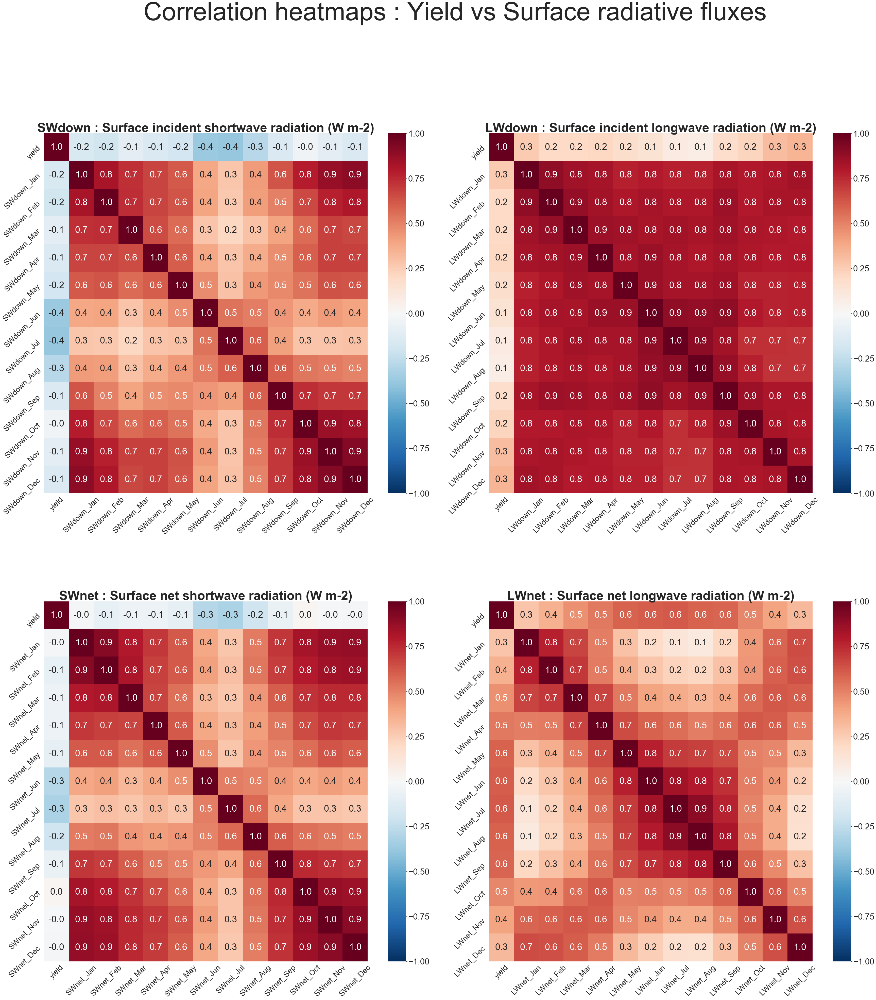

In [53]:
corr_heatmap_yield_climate(['SWdown', 'LWdown', 'SWnet', 'LWnet'], \
                           'Yield vs Surface radiative fluxes')

---
## Correlation heatmaps: yield vs latent, sensible, and ground heat fluxes

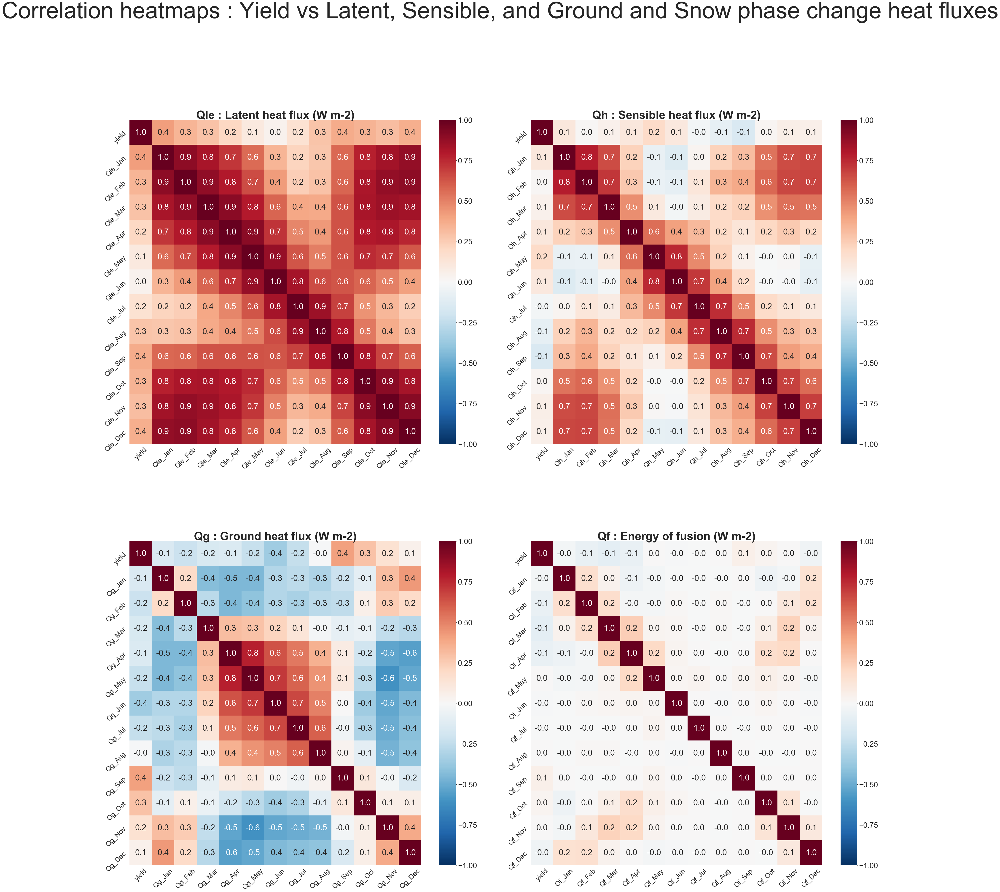

In [54]:
corr_heatmap_yield_climate(['Qle', 'Qh', 'Qg', 'Qf'], \
                           'Yield vs Latent, Sensible, and Ground and Snow phase change heat fluxes')

---
## Correlation heatmaps: Yield vs Water fluxes


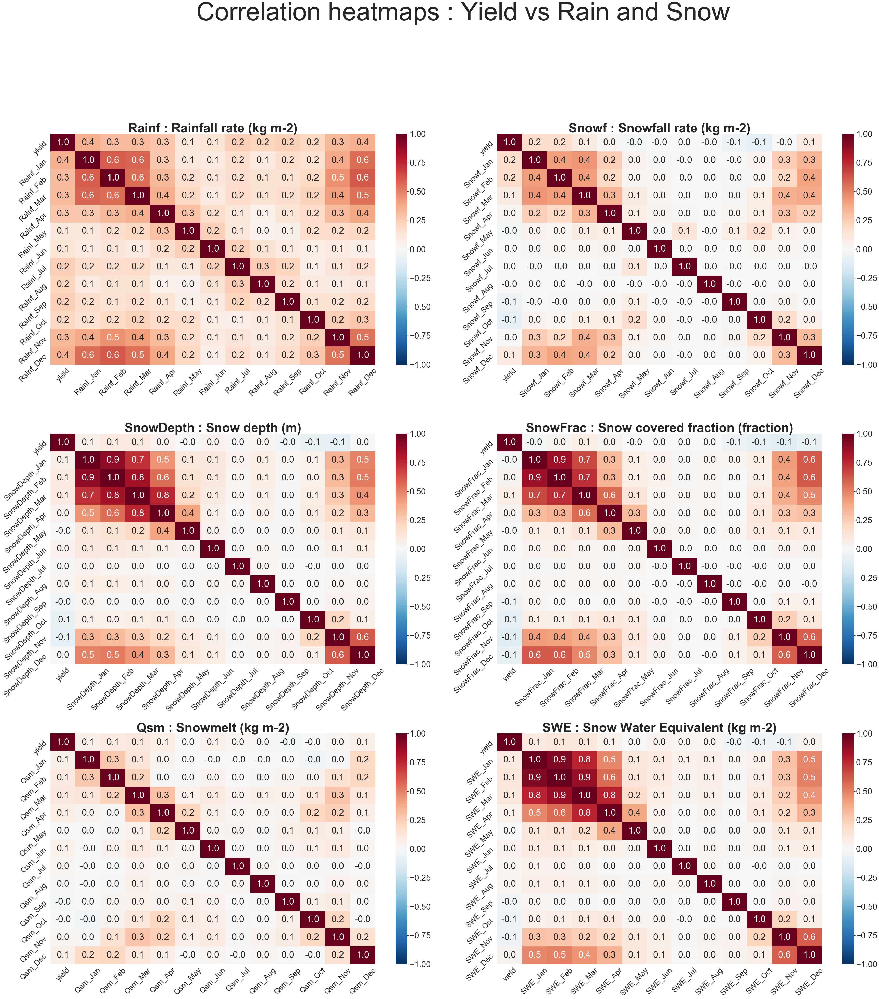

In [55]:
corr_heatmap_yield_climate(['Rainf', 'Snowf', 'SnowDepth', 'SnowFrac', 'Qsm', 'SWE'], \
                           'Yield vs Rain and Snow')

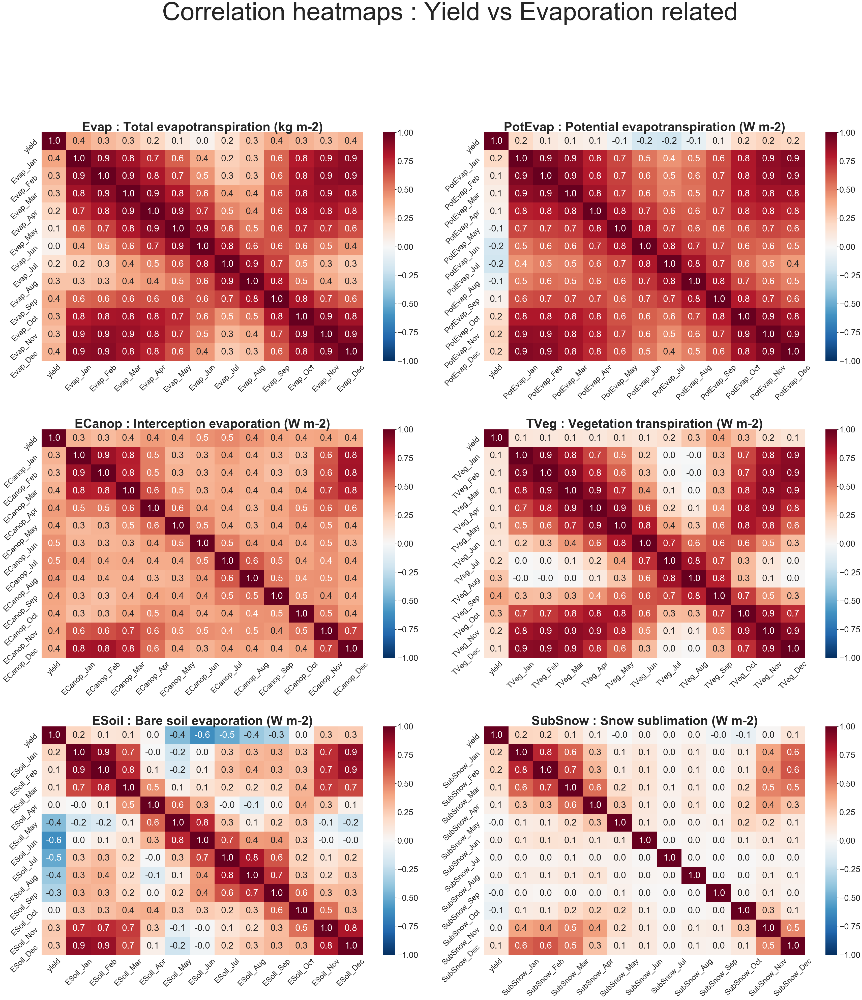

In [60]:
corr_heatmap_yield_climate(['Evap', 'PotEvap', 'ECanop', 'TVeg', 'ESoil', 'SubSnow'], \
                           'Yield vs Evaporation related')

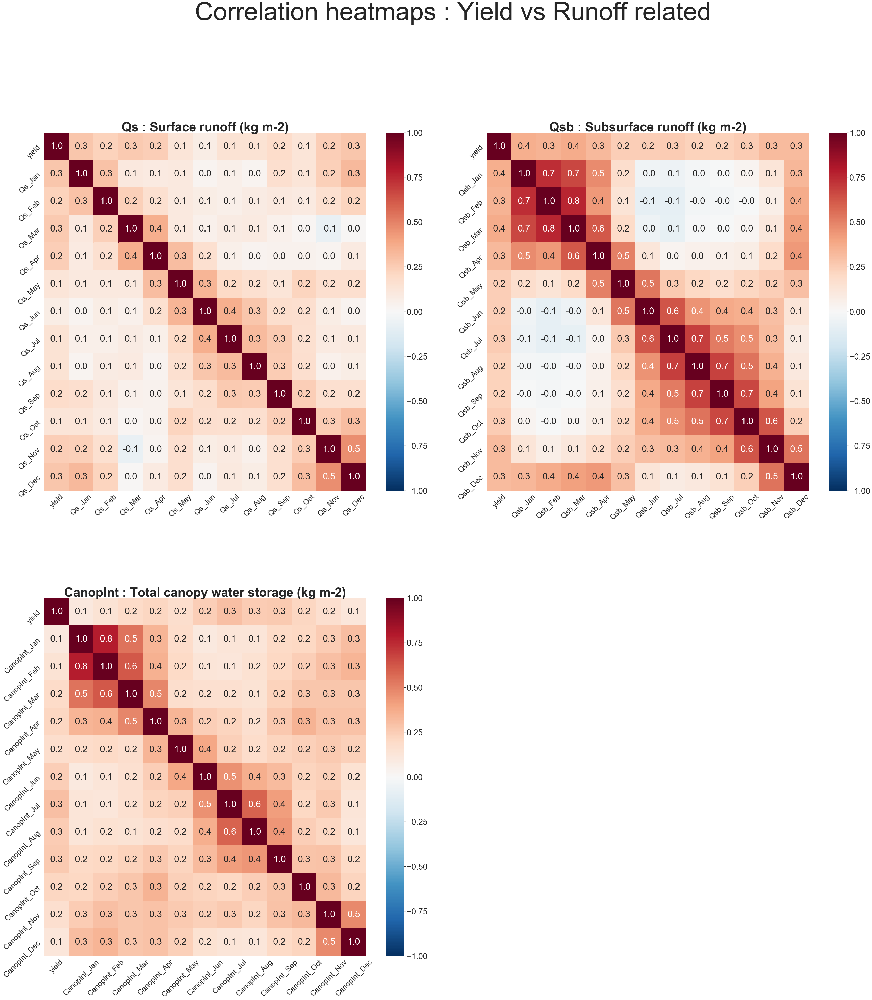

In [62]:
corr_heatmap_yield_climate(['Qs', 'Qsb', 'CanopInt'], \
                           'Yield vs Runoff related')


## Correlation heatmaps: Yield vs Temperature 

### Which depth of soil temperature matter?

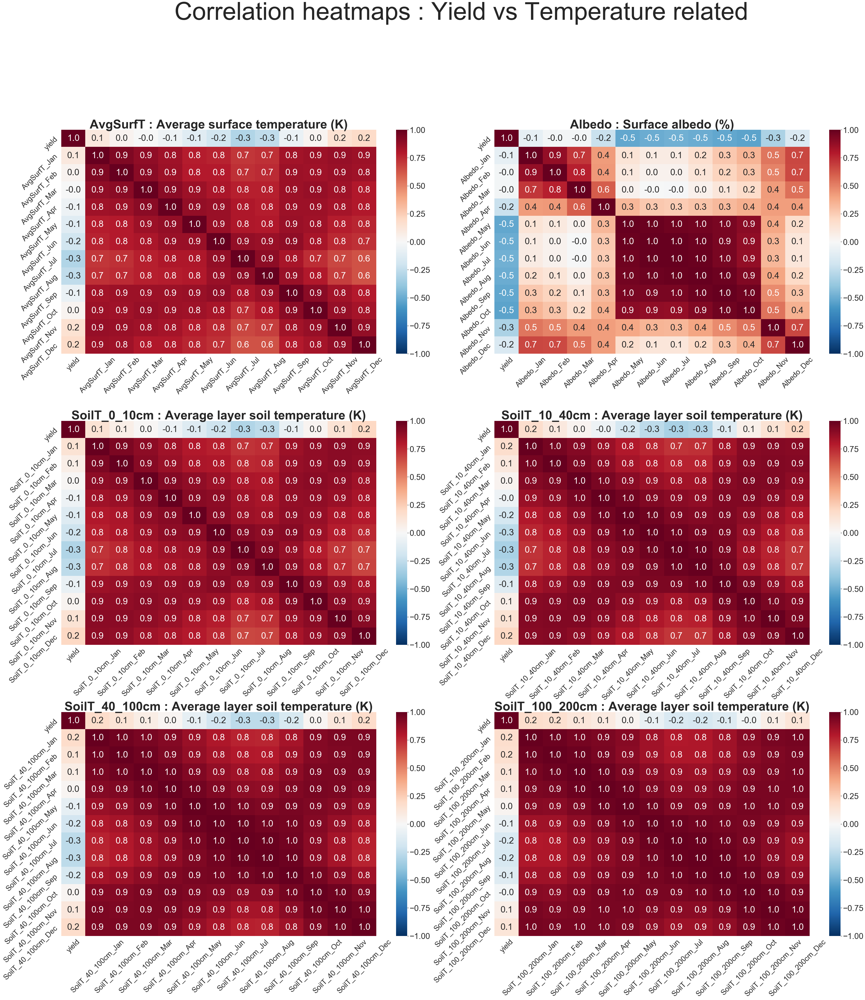

In [63]:
corr_heatmap_yield_climate(['AvgSurfT', 'Albedo', \
                            'SoilT_0_10cm', 'SoilT_10_40cm', 'SoilT_40_100cm', 'SoilT_100_200cm'], \
                           'Yield vs Temperature related')

## Correlation heatmaps: yield vs soil moisture 

#### Soil moisture
- 'SoilM_0_10cm': 'Soil moisture content (0-10cm) (kg m-2)'
- 'SoilM_10_40cm': 'Soil moisture content (10-40cm) (kg m-2)'
- 'SoilM_40_100cm': 'Soil moisture content (40-100cm) (kg m-2)'
- 'SoilM_100_200cm': 'Soil moisture content (100-200cm) (kg m-2)'
- 'SoilM_0_100cm': 'Soil moisture content (0-100cm) (kg m-2)'
- 'SoilM_0_200cm': 'Soil moisture content (0-200cm) (kg m-2)'
- 'RootMoist': 'Root zone soil moisture (kg m-2)'

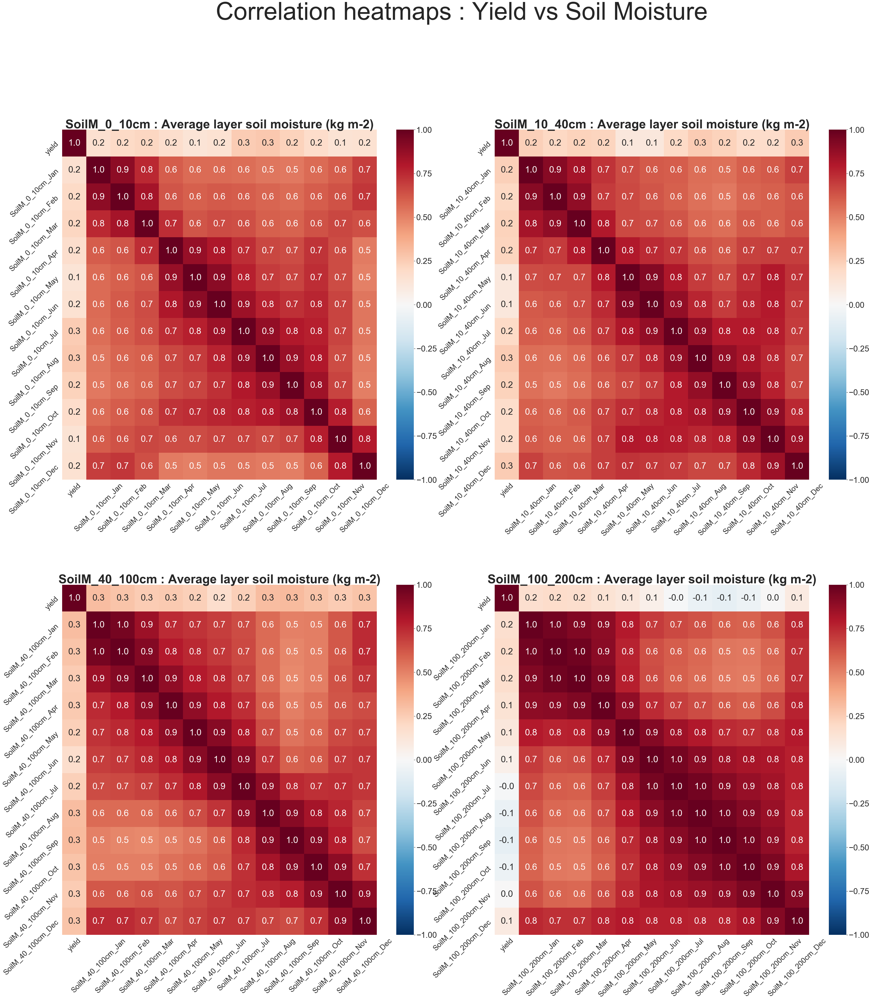

In [65]:
corr_heatmap_yield_climate(['SoilM_0_10cm', 'SoilM_10_40cm', 'SoilM_40_100cm', 'SoilM_100_200cm'], \
                           'Yield vs Soil Moisture')

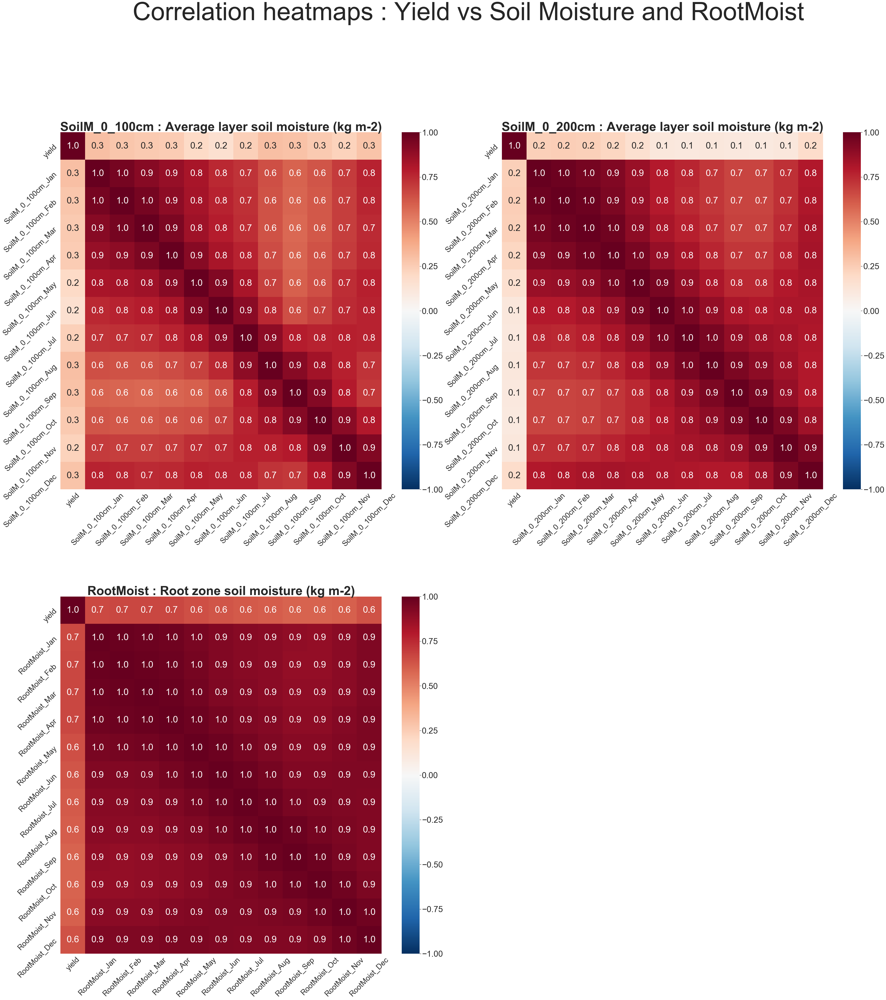

In [66]:
corr_heatmap_yield_climate(['SoilM_0_100cm', 'SoilM_0_200cm', 'RootMoist'], \
                           'Yield vs Soil Moisture and RootMoist')

---
## Correlation heatmap: Yield vs Land surface parameters

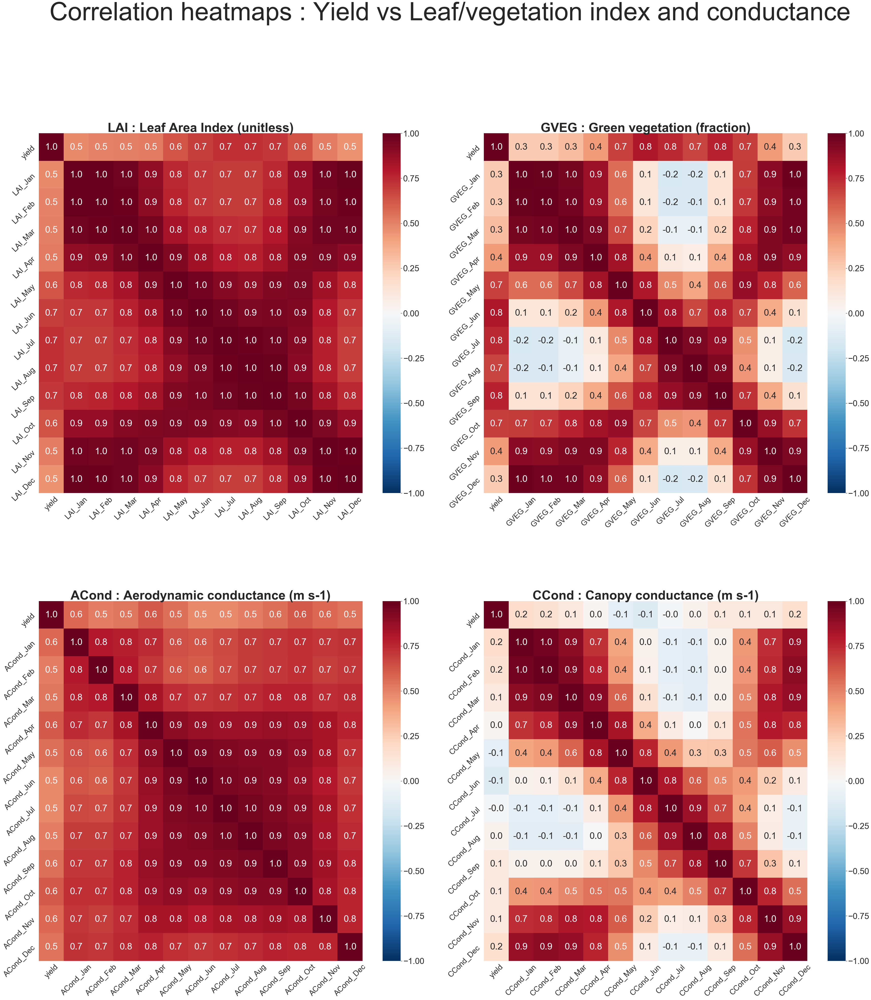

In [82]:
corr_heatmap_yield_climate(['LAI', 'GVEG', 'ACond', 'CCond'], \
                           'Yield vs Leaf/vegetation index and conductance')

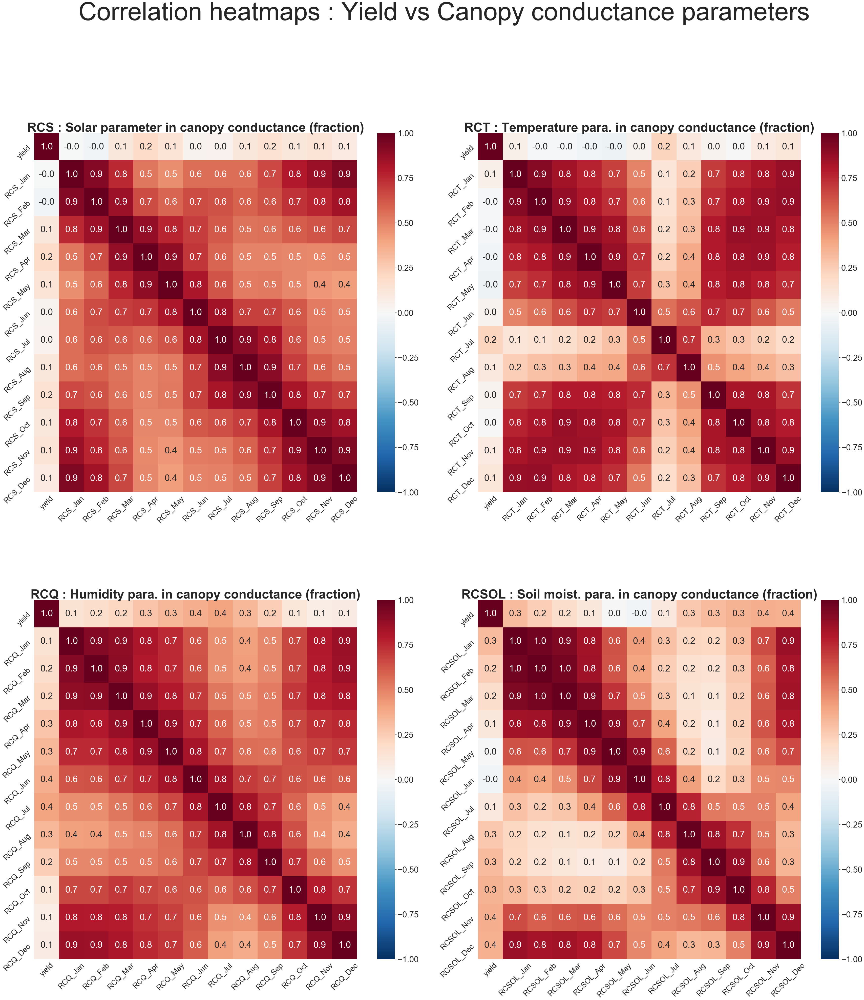

In [83]:
corr_heatmap_yield_climate(['RCS', 'RCT', 'RCQ', 'RCSOL'], \
                           'Yield vs Canopy conductance parameters')

---
# Explore correlation among variables 

Check the correlation between SW, LW, SWnet, LWnet, LH, SH with soil temperature
If ST has high correlation with one (or more) of the surface energy fluxes, take that out

Check the relationship between SM and ST --> suspect surface level SM is highly correlated with ST


In [146]:
def corr_heatmap_climate(*args):
    '''
    Purpose:
    Correlation heatmaps for visualizing the pairwise pearson correlation between climate variables.

    The goal is to figure out redundant features. 
    
    Parameters:
    var is a list of climate variable names; title is a user-defined suptitle for the panel plot
    
    Caveat:
    This approach is based on a linear correlation assumption. 
    '''
    
    plt.figure(figsize=(100,100), linewidth=40)
    plt.subplots_adjust(hspace=0.3)
    plt.subplots_adjust(wspace=0.1)
    #plt.suptitle("Correlation heatmaps : "+title, fontsize=100, y = 1.0)

    sns.set(font_scale=5)

    # ---- set number of columns 
    ncols     = 2
    # ---- calculate number of rows
    nrows = len(args) // ncols + (len(args) % ncols > 0)
    
    for n, pair in enumerate(args):
        ax     = plt.subplot(nrows, ncols, n + 1)
        
        cols_1 = [col for col in data_filled.columns if col.startswith(pair[0]+'_')]
        cols_2 = [col for col in data_filled.columns if col.startswith(pair[1]+'_')]
        cols   = cols_1 + cols_2
        df     = data_filled[cols]
        corr   = df.corr()
    
        res = sns.heatmap(corr, annot=True, fmt='.1f', cmap='RdBu_r', vmin=-1, vmax=1, ax=ax)
        res.set_xticklabels(res.get_xmajorticklabels(), fontsize = 50, rotation=45)
        res.set_yticklabels(res.get_ymajorticklabels(), fontsize = 50, rotation=45)
        res.set_title(pair[0] + ' vs '+pair[1], fontsize=100, fontweight='bold', y =  1.1)

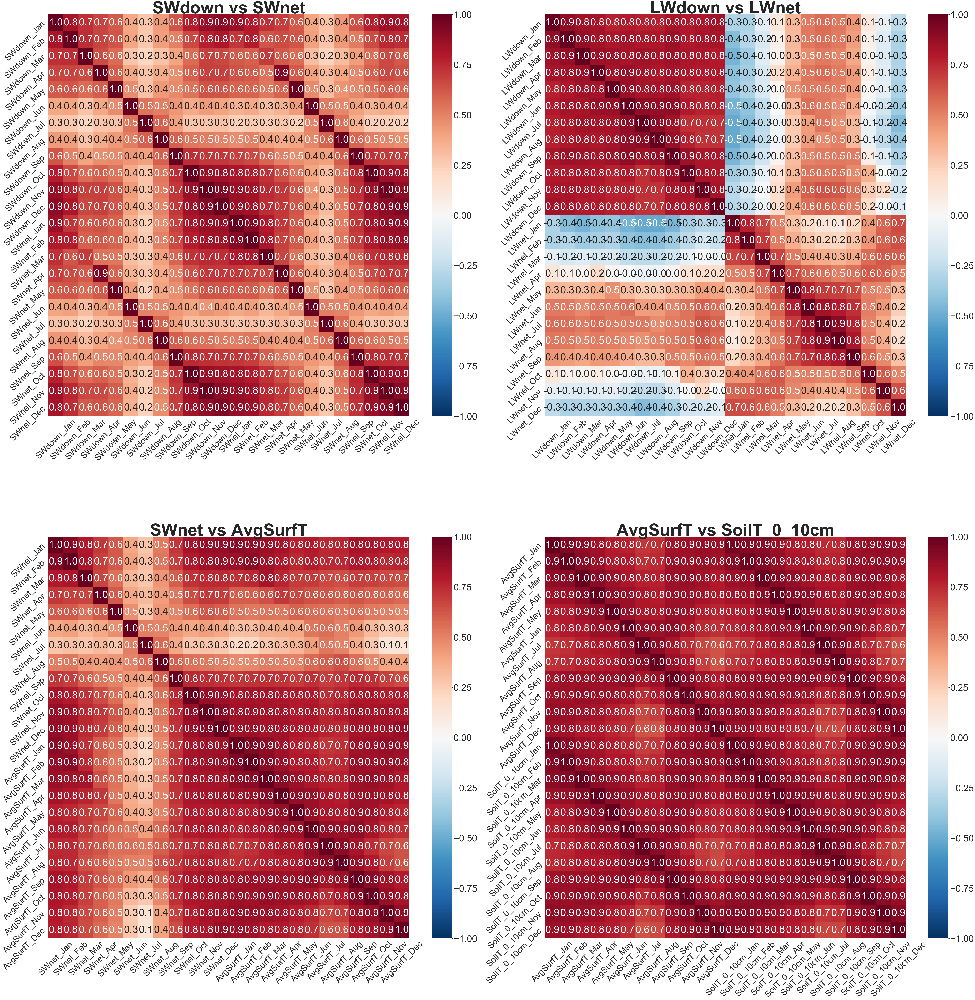

In [147]:
corr_heatmap_climate(['SWdown', 'SWnet'], ['LWdown', 'LWnet'], ['SWnet', 'AvgSurfT'], ['AvgSurfT', 'SoilT_0_10cm'])

---
## `For variables that show weak linear correlations with Yield, plot out the scatter plot, and see whether they actually have nonlinear relationship with Yield`

# Explore connection with the previous winter

- SnowDepth
- SnowFrac
- Snowf
- Rainf
- RootMoist
- `Nov and Dec of the above variables`

Consider Yield (lat, lon, year) with year from 1982 to 2016. 
For each year, obtain the lat/lon corresponding Dec varialbe from the previous year. If the value is missing from the previous year, see whether we can fill the NaN with the interpolation method. 

In [151]:
yield_lag = data_filled[data_filled['year'] >= 1982][['lat','lon', 'year', 'yield']].reset_index(drop=True)
yield_lag.head()

,lat,lon,year,yield
0,25.25,252.25,1982,0.899150
1,25.25,261.25,1982,0.712989
2,25.25,261.75,1982,0.842316
3,25.75,251.75,1982,0.572019
4,25.75,252.25,1982,1.361995


## Define a function to fetch climate information from previous year. 

In [280]:
# ---- Create a list of lead variables 
lead_climate_var  = ['SnowDepth', 'SnowFrac', 'Snowf', 'Rainf', 'RootMoist']
lead_climate_month= ['Nov', 'Dec']
lead_climate_list = []
for var in lead_climate_var:
    for month in lead_climate_month:
        lead_climate_list.append(var+'_'+month)

        
# ---- New dataframe yield_lag_climate_lead
yield_lag_climate_lead = []
    
# ---- Fetching/engineering the corresponding lead climate variable from previous year
# ---- that corresponds to each yield grid point in 1982 to 2016
for year in range(1982, 2017):
    
    # 1. Read in the current year's data and obtain the total records from this year
    #    Set .reset_index(drop=True) so the index starts with zero
    yield_current   = yield_lag[yield_lag['year'] == year].reset_index(drop=True)
    yield_counts    = len(yield_current)
    
    # 2. Create a for loop to go through the lead_climate_list
    for lead in lead_climate_list:
        
        # 2.1 Create a new empty column in yield_current dataframe to store the lead variable
        yield_current['lead_'+lead] = ''
        
        # 2.2 Loop through the grids 
        for grid in range(0, yield_counts):
            lat = yield_current['lat'][grid]
            lon = yield_current['lon'][grid]
            
            lead_df            = data_filled[data_filled['year'] == (year -1)][['lat', 'lon', lead]]
            lead_location      = (lead_df['lat'] == lat) & (lead_df['lon'] == lon)
            lead_series        = lead_df[lead_location].reset_index(drop=True)
        
            if lead_series.empty:
                yield_current['lead_'+lead][grid] = ''
            else:
                yield_current['lead_'+lead][grid] = lead_series[lead][0]

        
        # 2.3 Fill in the null values with the interpolation method
        if yield_current['lead_'+lead].isnull().values.any():
            yield_current['lead_'+lead].interpolate(method='linear', direction = 'forward', inplace=True)
        
        
        # 2.4 Replace negative values with 0
        #yield_current[int(yield_current['lead_'+lead]) < 0]['lead_'+lead] = 0
        #yield_current['lead_'+lead] = yield_current['lead_'+lead].mask(yield_current['lead_'+lead].lt(0),0)
        
    # 3. Append the updated yield_current to yield_lag_climate_lead df
    yield_lag_climate_lead.append(yield_current)
    print('Updating year '+ str(year)+' done ...')

data_filled_with_climate_lead = pd.concat(yield_lag_climate_lead)

/Users/wenwen/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:40: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/Users/wenwen/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:38: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


Updating year 1982 done ...
Updating year 1983 done ...
Updating year 1984 done ...
Updating year 1985 done ...
Updating year 1986 done ...
Updating year 1987 done ...
Updating year 1988 done ...
Updating year 1989 done ...
Updating year 1990 done ...
Updating year 1991 done ...
Updating year 1992 done ...
Updating year 1993 done ...
Updating year 1994 done ...
Updating year 1995 done ...
Updating year 1996 done ...
Updating year 1997 done ...
Updating year 1998 done ...
Updating year 1999 done ...
Updating year 2000 done ...
Updating year 2001 done ...
Updating year 2002 done ...
Updating year 2003 done ...
Updating year 2004 done ...
Updating year 2005 done ...
Updating year 2006 done ...
Updating year 2007 done ...
Updating year 2008 done ...
Updating year 2009 done ...
Updating year 2010 done ...
Updating year 2011 done ...
Updating year 2012 done ...
Updating year 2013 done ...
Updating year 2014 done ...
Updating year 2015 done ...
Updating year 2016 done ...


In [281]:
data_filled_with_climate_lead.info

<bound method DataFrame.info of         lat     lon  year     yield lead_SnowDepth_Nov lead_SnowDepth_Dec  \
0     25.25  252.25  1982  0.899150                  0                  0   
1     25.25  261.25  1982  0.712989                                         
2     25.25  261.75  1982  0.842316                  0                  0   
3     25.75  251.75  1982  0.572019                  0                  0   
4     25.75  252.25  1982  1.361995                  0        1.04167e-06   
...     ...     ...   ...       ...                ...                ...   
1414  48.75  264.75  2016  3.735792         0.00196799          0.0602838   
1415  48.75  287.25  2016  2.936604         0.00309799           0.151268   
1416  48.75  287.75  2016  2.824051         0.00240552           0.137725   
1417  48.75  288.25  2016  2.862302         0.00171306           0.124181   
1418  48.75  288.75  2016  3.414211         0.00251802           0.198643   

     lead_SnowFrac_Nov lead_SnowFrac_Dec le

In [282]:
lead_lag_cols = data_filled_with_climate_lead.columns[3:]
data_filled_with_climate_lead[lead_lag_cols].info

<bound method DataFrame.info of          yield lead_SnowDepth_Nov lead_SnowDepth_Dec lead_SnowFrac_Nov  \
0     0.899150                  0                  0                 0   
1     0.712989                                                           
2     0.842316                  0                  0                 0   
3     0.572019                  0                  0                 0   
4     1.361995                  0        1.04167e-06                 0   
...        ...                ...                ...               ...   
1414  3.735792         0.00196799          0.0602838         0.0304167   
1415  2.936604         0.00309799           0.151268         0.0380903   
1416  2.824051         0.00240552           0.137725         0.0279861   
1417  2.862302         0.00171306           0.124181         0.0178819   
1418  3.414211         0.00251802           0.198643         0.0286806   

     lead_SnowFrac_Dec lead_Snowf_Nov lead_Snowf_Dec lead_Rainf_Nov  \
0       

In [283]:
lead_lag_test = data_filled_with_climate_lead[lead_lag_cols]
for col in lead_lag_cols:
    lead_lag_test[col] = pd.to_numeric(lead_lag_test[col])
    
lead_lag_corr= lead_lag_test.corr()
lead_lag_corr

/Users/wenwen/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  This is separate from the ipykernel package so we can avoid doing imports until


,yield,lead_SnowDepth_Nov,lead_SnowDepth_Dec,lead_SnowFrac_Nov,lead_SnowFrac_Dec,lead_Snowf_Nov,lead_Snowf_Dec,lead_Rainf_Nov,lead_Rainf_Dec,lead_RootMoist_Nov,lead_RootMoist_Dec
yield,1.000000,-0.073210,0.000407,-0.101637,-0.062598,-0.001098,0.092973,0.343929,0.345342,0.613806,0.641541
lead_SnowDepth_Nov,-0.073210,1.000000,0.625179,0.897096,0.539685,0.775385,0.156322,-0.200748,-0.220536,-0.038546,-0.067247
lead_SnowDepth_Dec,0.000407,0.625179,1.000000,0.576003,0.849512,0.679843,0.650650,-0.230318,-0.329764,0.048549,-0.007534
lead_SnowFrac_Nov,-0.101637,0.897096,0.576003,1.000000,0.597335,0.791118,0.181076,-0.251099,-0.286808,-0.071612,-0.106682
lead_SnowFrac_Dec,-0.062598,0.539685,0.849512,0.597335,1.000000,0.631562,0.674485,-0.318806,-0.450348,-0.044508,-0.106444
lead_Snowf_Nov,-0.001098,0.775385,0.679843,0.791118,0.631562,1.000000,0.312033,-0.198033,-0.295817,0.072774,0.028091
lead_Snowf_Dec,0.092973,0.156322,0.650650,0.181076,0.674485,0.312033,1.000000,-0.117403,-0.251813,0.161577,0.119151
lead_Rainf_Nov,0.343929,-0.200748,-0.230318,-0.251099,-0.318806,-0.198033,-0.117403,1.000000,0.543752,0.365657,0.449542
lead_Rainf_Dec,0.345342,-0.220536,-0.329764,-0.286808,-0.450348,-0.295817,-0.251813,0.543752,1.000000,0.258778,0.390367
lead_RootMoist_Nov,0.613806,-0.038546,0.048549,-0.071612,-0.044508,0.072774,0.161577,0.365657,0.258778,1.000000,0.977033


Text(0.5, 1.1, 'Yield vs Lead winter conditions')

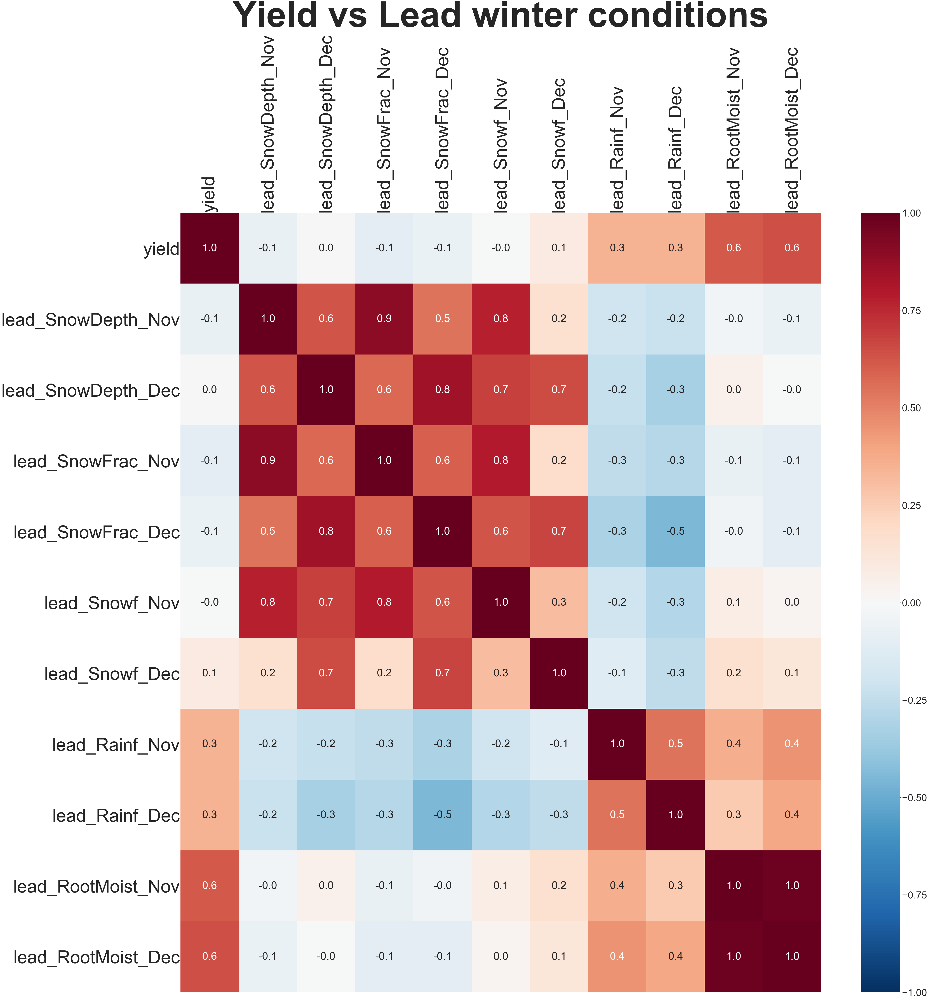

In [291]:
plt.figure(figsize=(80,80), linewidth=20)
sns.set(font_scale=5)
res = sns.heatmap(lead_lag_corr, annot=True, fmt='.1f', cmap='RdBu_r', vmin=-1, vmax=1)
res.set_xticklabels(res.get_xmajorticklabels(), fontsize = 100, rotation=90)
res.set_yticklabels(res.get_ymajorticklabels(), fontsize = 100, rotation=0)
res.xaxis.tick_top() # x axis on top
res.xaxis.set_label_position('top')
res.tick_params(length=0)
res.set_title('Yield vs Lead winter conditions', fontsize=200, fontweight='bold', y =  1.1)

## Both `Rainf` and `RootMoist` in the previous Nov and Dec look like promising predictors

##  ---> Worth to check if the earlier season `RootMoist` in the previous year matters